<a href="https://colab.research.google.com/github/vivek-varma/CS_415/blob/main/h2_files_Q4/HW_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow


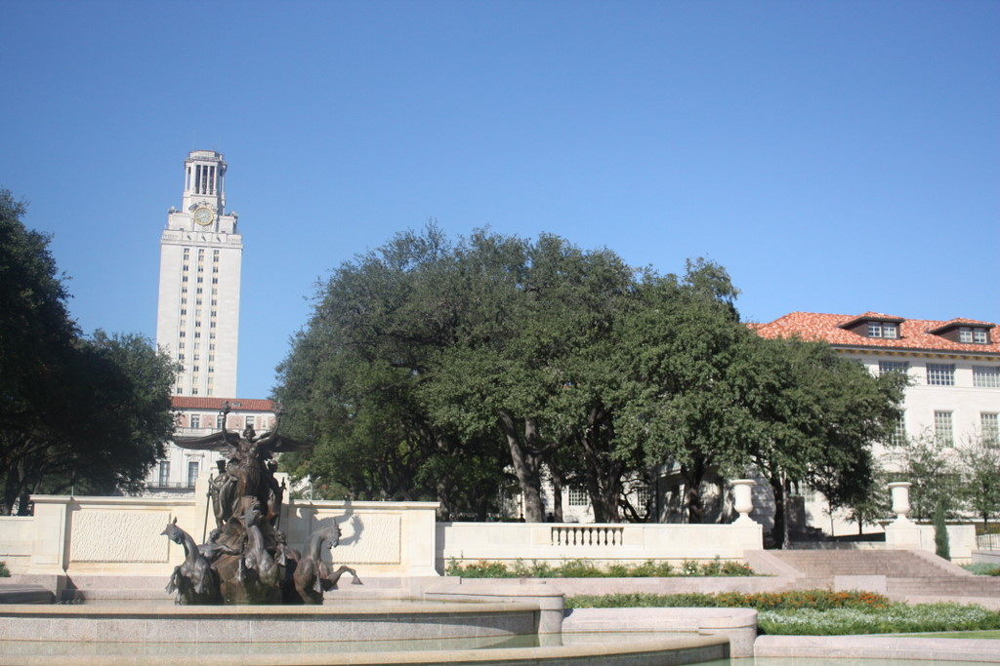

In [ ]:
filename = 'left1.jpg'
img_left = cv2.imread(filename)
#cv2.imshow(img)
cv2_imshow(img_left)

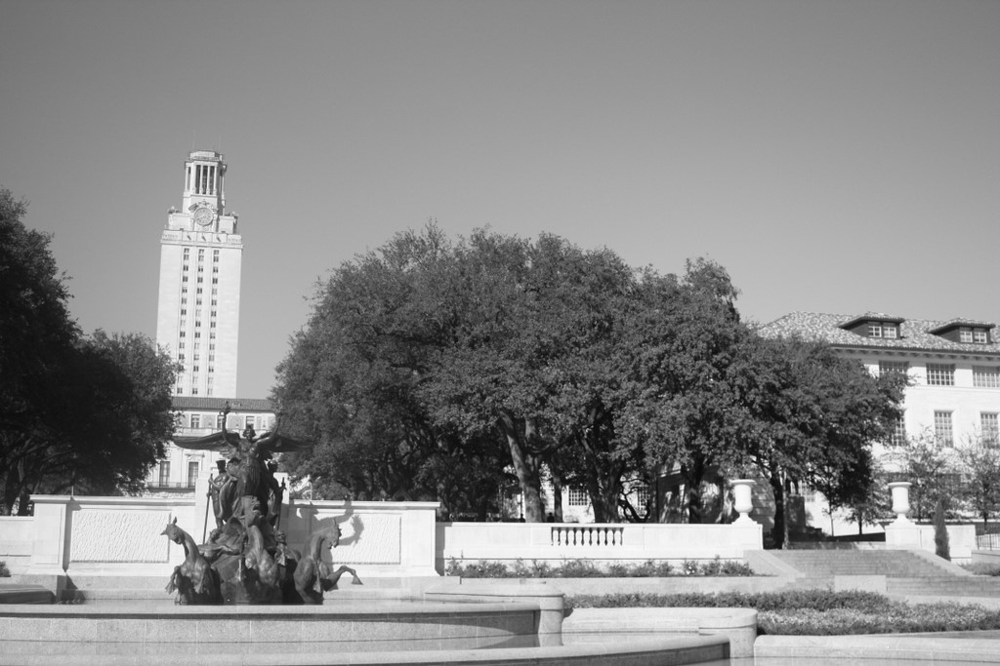

In [ ]:
gray_left = cv2.cvtColor(img_left,cv2.COLOR_BGR2GRAY)
gray_left = np.float32(gray_left)
cv2_imshow(gray_left)

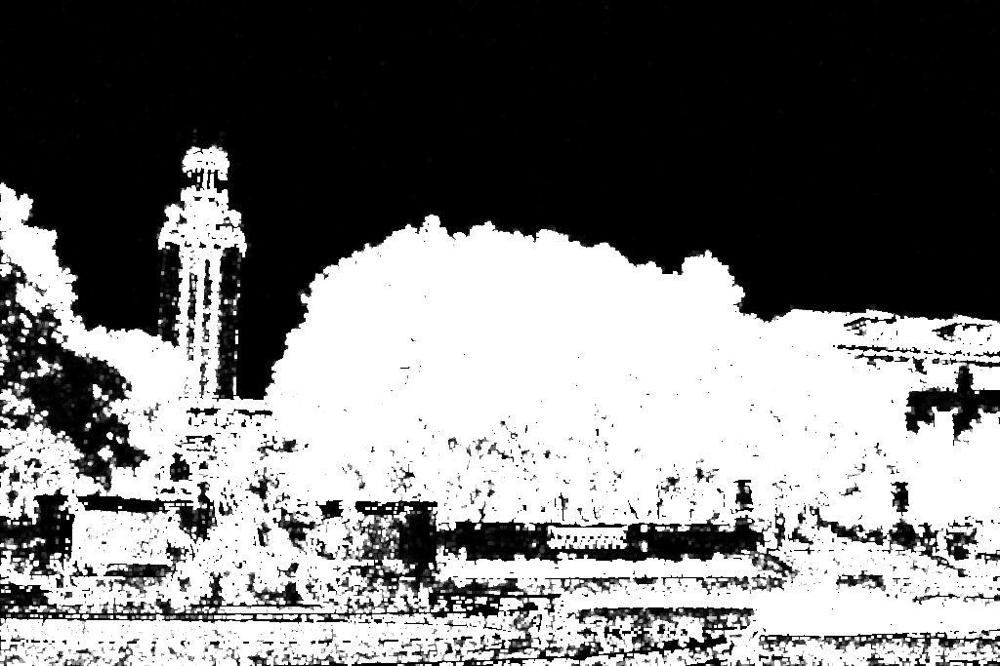

[[ 1.0881250e+00  1.3466406e+00  1.3466406e+00 ...  1.2915626e+00
   1.6292578e+00  1.6292578e+00]
 [ 1.0881250e+00  1.3466406e+00  1.3466406e+00 ...  1.2915626e+00
   1.6292578e+00  1.6292578e+00]
 [ 1.0881250e+00  1.3466406e+00  1.3466406e+00 ...  1.2915626e+00
   1.6292578e+00  1.6292578e+00]
 ...
 [ 1.6674509e+02  1.6674509e+02  1.6674509e+02 ... -2.8467879e+04
  -2.5475188e+04 -2.5475188e+04]
 [ 1.4309146e+04  1.4309146e+04  1.4309146e+04 ...  5.7849579e+01
  -7.0481873e+01 -7.0481873e+01]
 [ 1.4309146e+04  1.4309146e+04  1.4309146e+04 ...  5.7849579e+01
  -7.0481873e+01 -7.0481873e+01]]


In [ ]:
dst_left = cv2.cornerHarris(gray_left,2,3,0.04)
dst_left = cv2.dilate(dst_left,None)
cv2_imshow(dst_left)
print(dst_left)

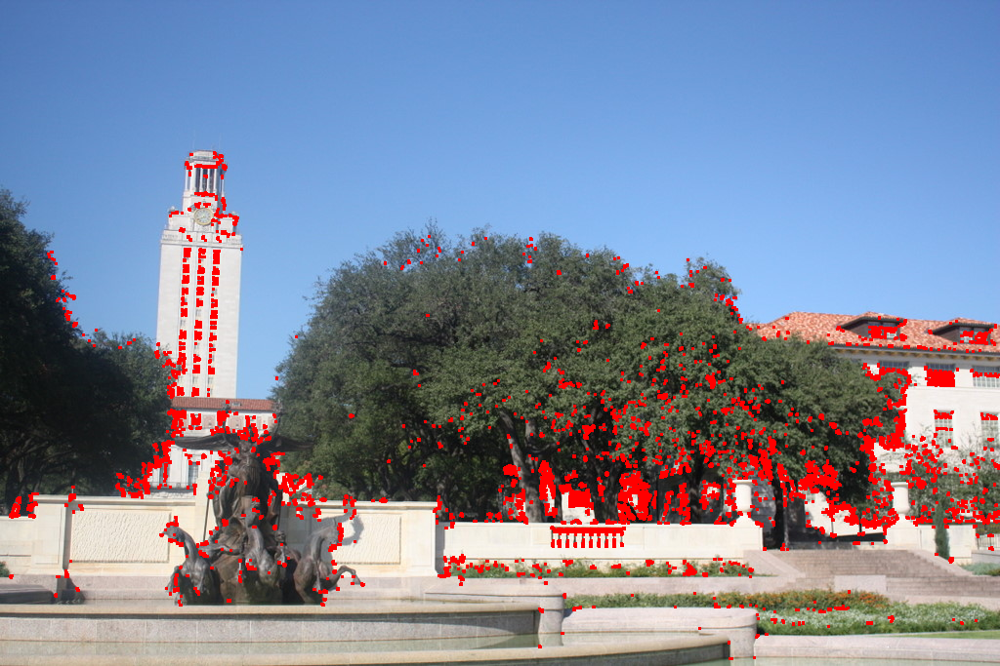

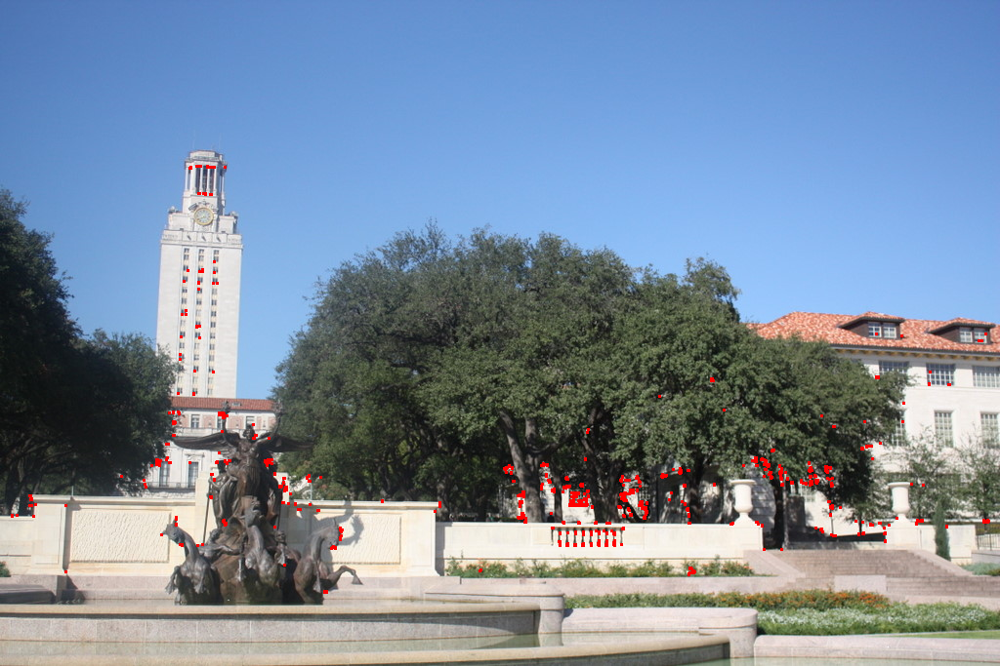

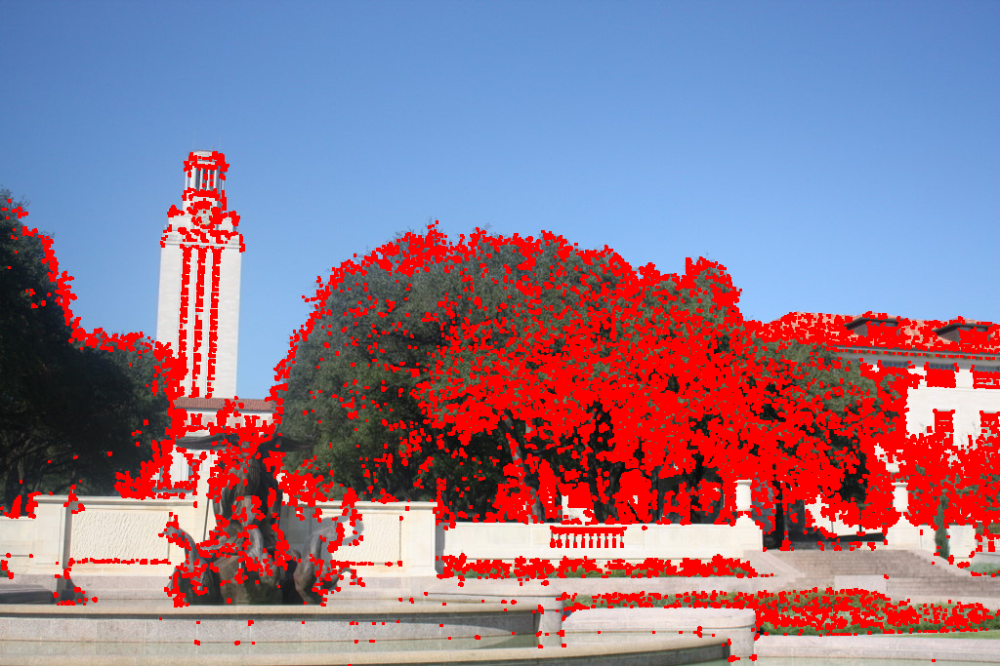

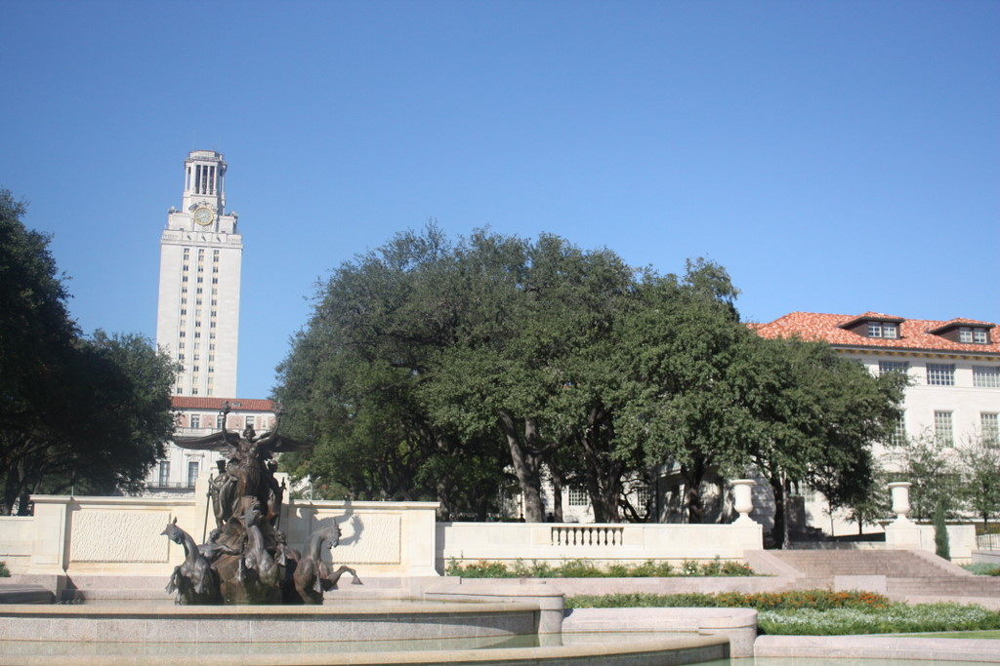

In [ ]:
img1_left = img_left.copy()
img2_left = img_left.copy()
img3_left = img_left.copy()
img4_left = img_left.copy()

img1_left[dst_left>0.01*dst_left.max()]=[0,0,255]
img2_left[dst_left>0.1*dst_left.max()]=[0,0,255]
img3_left[dst_left>0.001*dst_left.max()]=[0,0,255]
img4_left[dst_left>1*dst_left.max()]=[0,0,255]

cv2_imshow(img1_left)
cv2_imshow(img2_left)
cv2_imshow(img3_left)
cv2_imshow(img4_left)

#if cv2.waitKey(0) & 0xff == 27:
 #   cv2.destroyAllWindows()

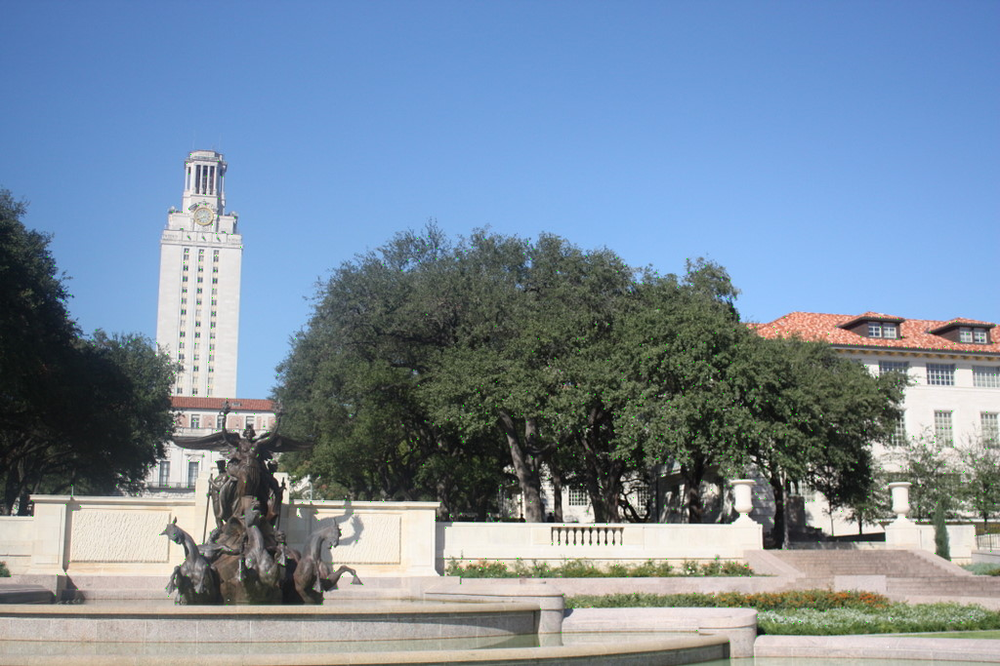

In [ ]:
ret, dst_left = cv2.threshold(dst_left,0.01*dst_left.max(),255,0)
dst_left = np.uint8(dst_left)

# find centroids
ret, labels, stats, centroids = cv2.connectedComponentsWithStats(dst_left)

# define the criteria to stop and refine the corners
criteria_left = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
corners_left = cv2.cornerSubPix(gray_left,np.float32(centroids),(5,5),(-1,-1),criteria_left)
#print(corners_left)    #here u can get corners check for more information follow the link...........http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_features_harris/py_features_harris.html
# Now draw them
res = np.hstack((centroids,corners_left))
res = np.int0(res)
img_left_1 = img_left.copy()
#img_left[res[:,1],res[:,0]]=[0,0,255]
img_left_1[res[:,3],res[:,2]] = [0,255,0]

cv2_imshow(img_left_1)

In [ ]:
corner_keypoints_left = [cv2.KeyPoint(pt[0], pt[1], 13) for pt in corners_left]

print(corner_keypoints_left)


[<KeyPoint 0x7f4c28227900>, <KeyPoint 0x7f4c28227ae0>, <KeyPoint 0x7f4c282278d0>, <KeyPoint 0x7f4c28227f90>, <KeyPoint 0x7f4c28227750>, <KeyPoint 0x7f4c28227030>, <KeyPoint 0x7f4c282279f0>, <KeyPoint 0x7f4c28227b10>, <KeyPoint 0x7f4c282274b0>, <KeyPoint 0x7f4c282277e0>, <KeyPoint 0x7f4c28227c00>, <KeyPoint 0x7f4c28227330>, <KeyPoint 0x7f4c28227ea0>, <KeyPoint 0x7f4c28227720>, <KeyPoint 0x7f4c28249120>, <KeyPoint 0x7f4c28249030>, <KeyPoint 0x7f4c282490f0>, <KeyPoint 0x7f4c28249090>, <KeyPoint 0x7f4c282490c0>, <KeyPoint 0x7f4c28249060>, <KeyPoint 0x7f4c282491e0>, <KeyPoint 0x7f4c28249180>, <KeyPoint 0x7f4c28249240>, <KeyPoint 0x7f4c282491b0>, <KeyPoint 0x7f4c282492a0>, <KeyPoint 0x7f4c28249210>, <KeyPoint 0x7f4c28249270>, <KeyPoint 0x7f4c282492d0>, <KeyPoint 0x7f4c28249300>, <KeyPoint 0x7f4c28249330>, <KeyPoint 0x7f4c282493c0>, <KeyPoint 0x7f4c282493f0>, <KeyPoint 0x7f4c28249420>, <KeyPoint 0x7f4c28249450>, <KeyPoint 0x7f4c28249540>, <KeyPoint 0x7f4c28249480>, <KeyPoint 0x7f4c28249510>, 

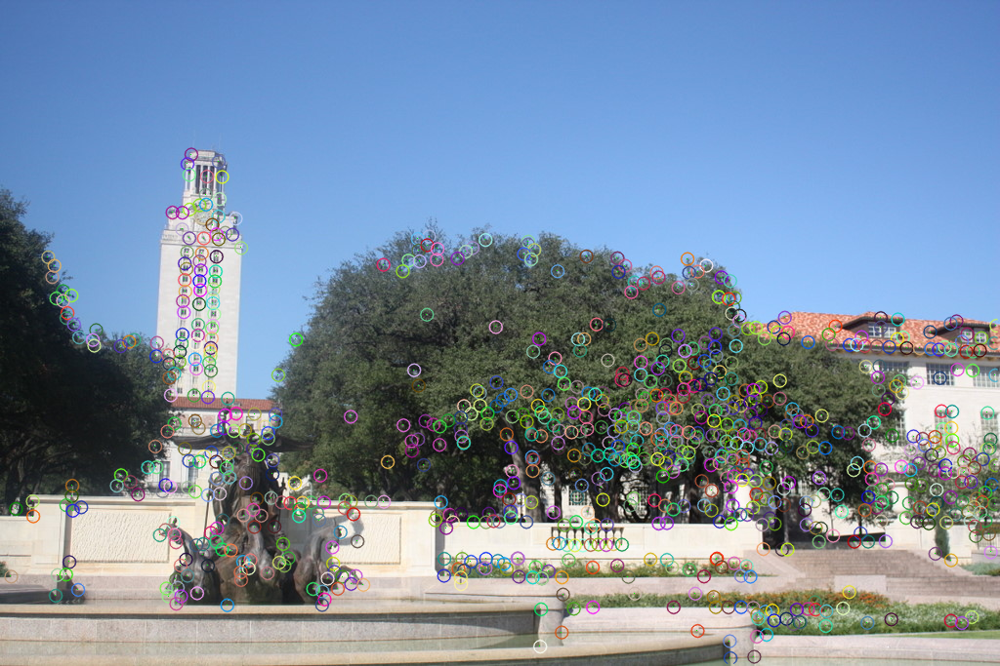

In [ ]:
mg=cv2.drawKeypoints(img_left_1, corner_keypoints_left, None, 
    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2_imshow(mg)

In [ ]:
f = cv2.BRISK_create()
#keypoints = f.detect(img)
descriptors_left = f.compute(img_left,corner_keypoints_left)
descriptors_left = descriptors_left[1]

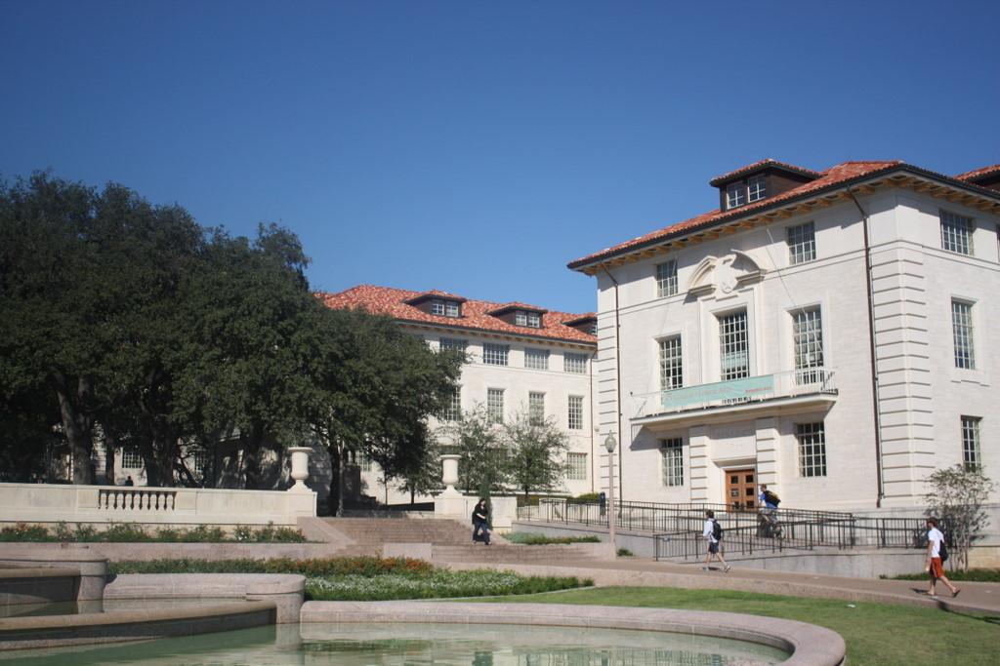

In [ ]:
filename = 'right1.jpg'
img_right = cv2.imread(filename)
#cv2.imshow(img)
cv2_imshow(img_right)

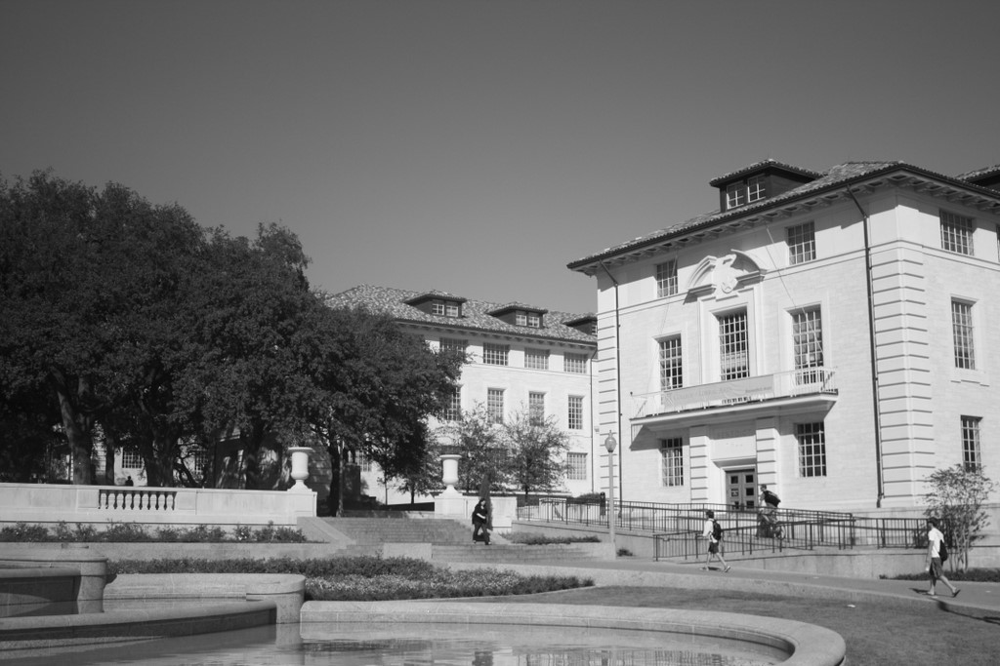

In [ ]:
gray_right = cv2.cvtColor(img_right,cv2.COLOR_BGR2GRAY)
gray_right = np.float32(gray_right)
cv2_imshow(gray_right)

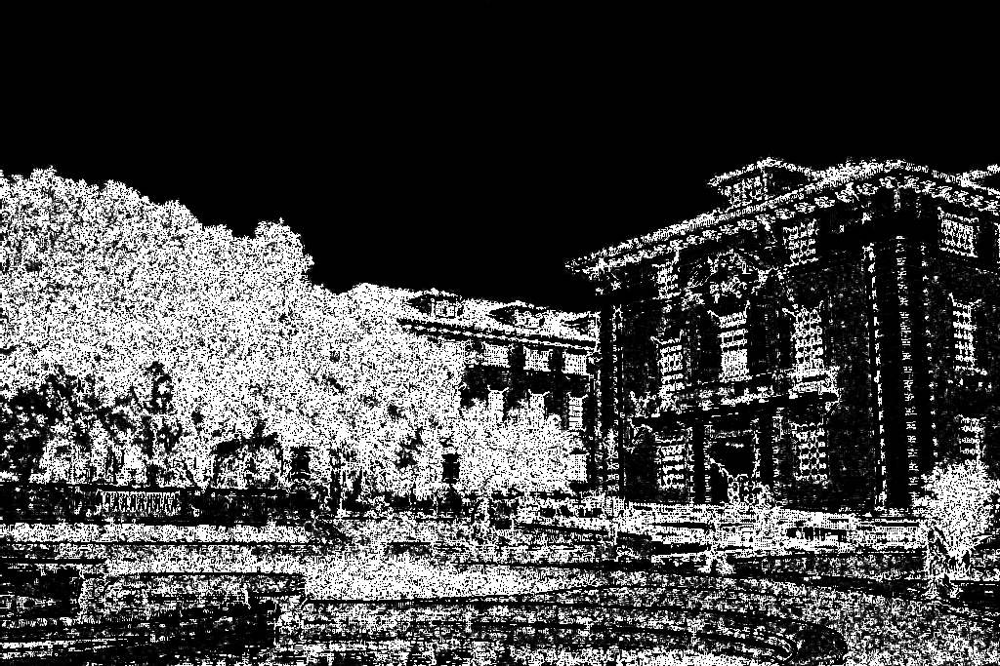

[[ 5.3027344e-01  5.3027344e-01  5.2320313e-01 ...  0.0000000e+00
   0.0000000e+00  0.0000000e+00]
 [ 5.3027344e-01  5.3027344e-01  5.2320313e-01 ...  0.0000000e+00
   0.0000000e+00  0.0000000e+00]
 [-1.3724217e+00 -1.3724217e+00 -9.5472658e-01 ... -9.9999998e-03
  -9.9999998e-03 -9.9999998e-03]
 ...
 [ 2.0738281e-01  2.0738281e-01  1.1508203e+00 ...  3.7787735e+01
   1.7373145e+02  8.3836694e+02]
 [ 3.7437499e-01  3.7437499e-01  1.4896094e+00 ...  1.9431641e+01
   2.0264380e+02  2.5769632e+02]
 [ 3.1625000e-01  3.1625000e-01  6.1625004e-01 ...  1.8978910e+00
   6.2510391e+01  3.3360508e+01]]


In [ ]:
dst_right = cv2.cornerHarris(gray_right,2,3,0.04)
dst_left = cv2.dilate(dst_left,None)
cv2_imshow(dst_right)
print(dst_right)

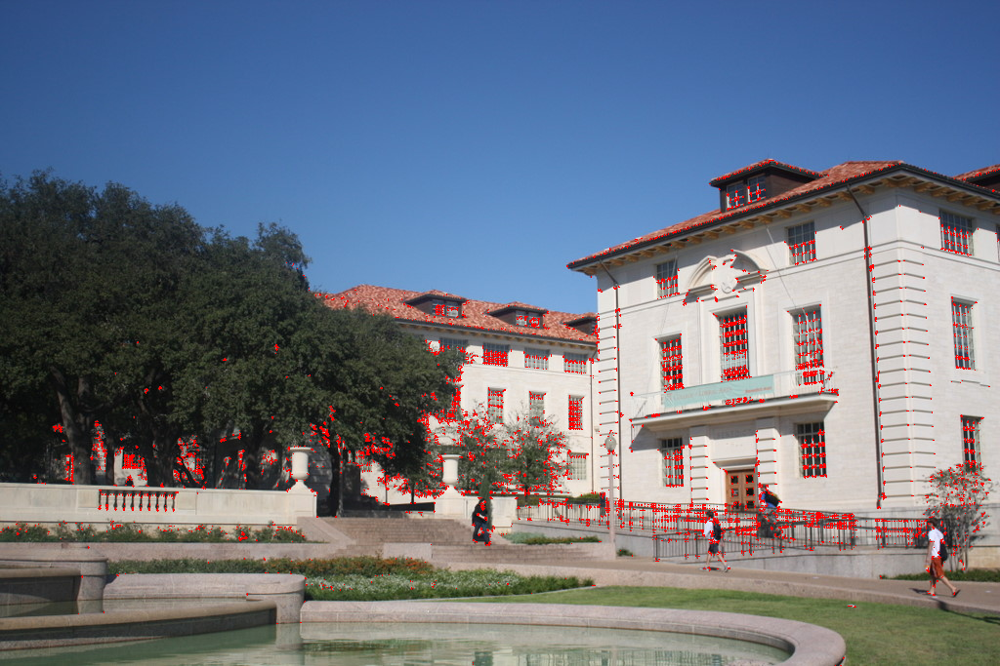

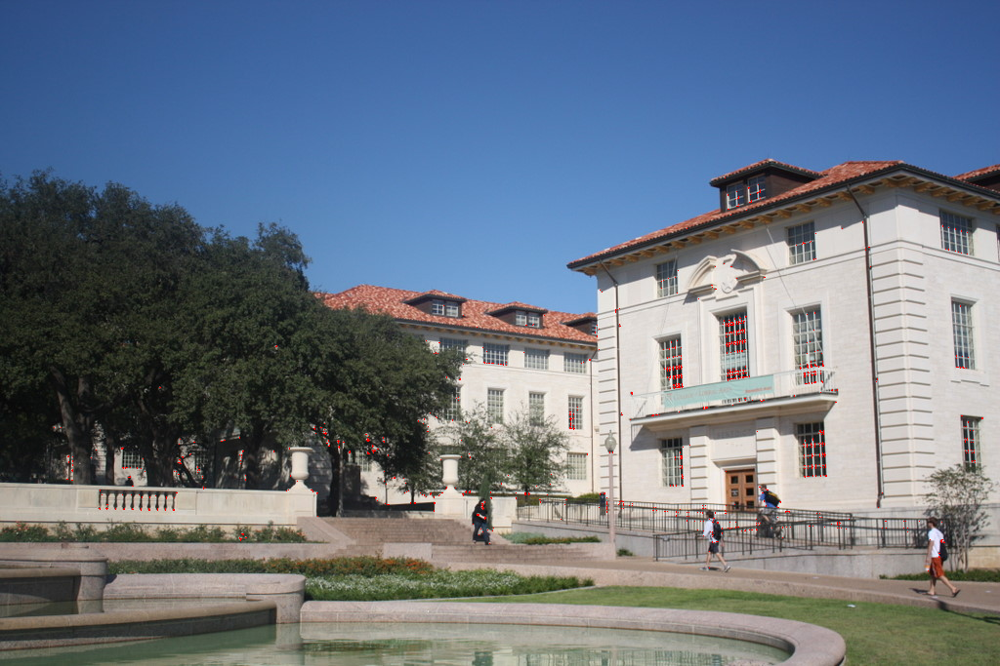

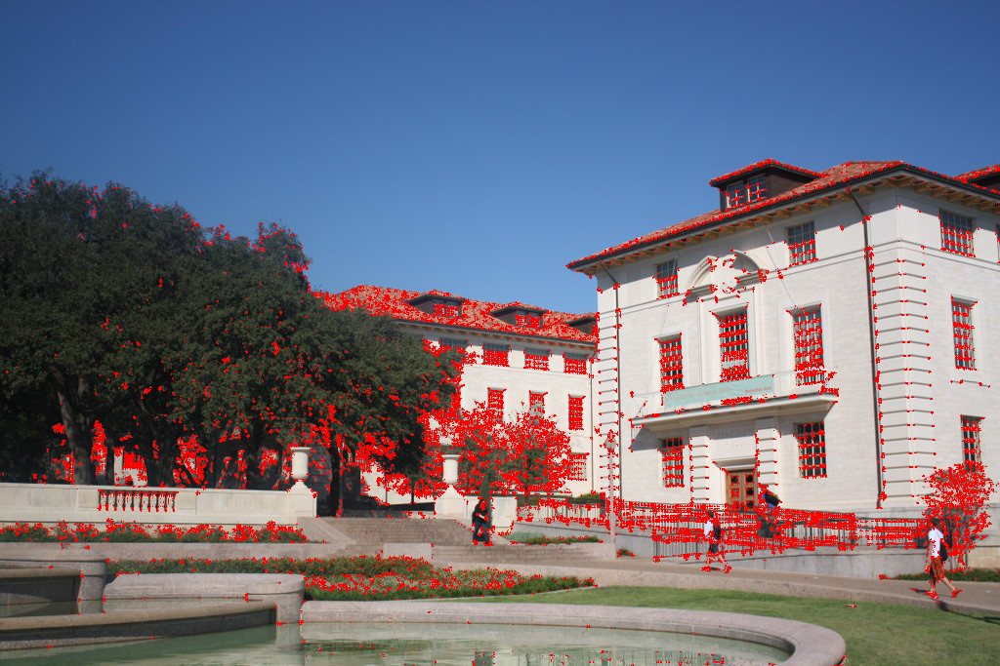

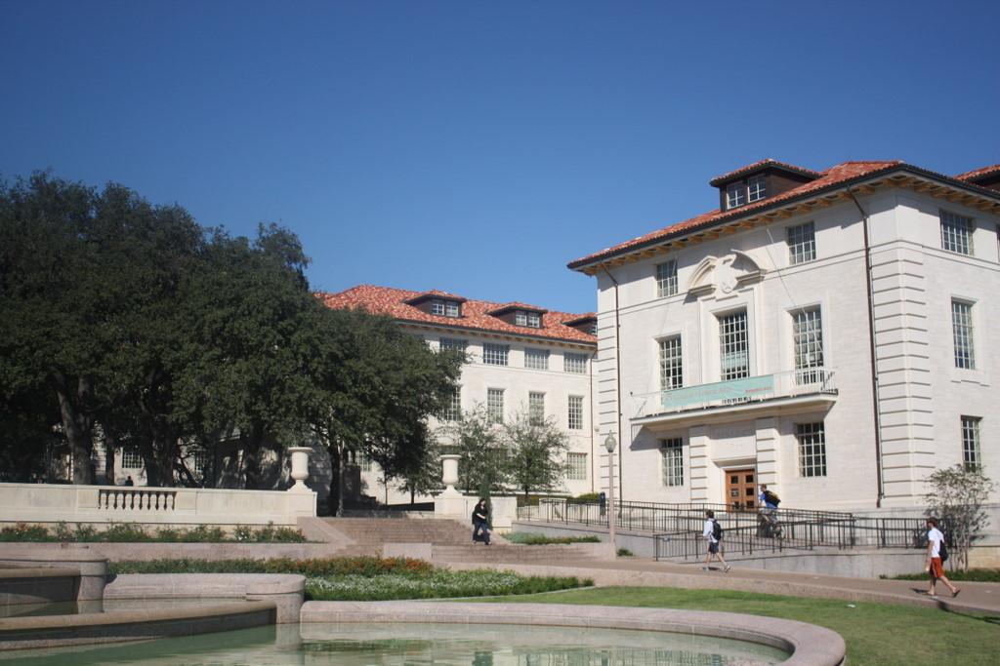

In [ ]:
img1_right = img_right.copy()
img2_right = img_right.copy()
img3_right = img_right.copy()
img4_right = img_right.copy()

img1_right[dst_right>0.01*dst_right.max()]=[0,0,255]
img2_right[dst_right>0.1*dst_right.max()]=[0,0,255]
img3_right[dst_right>0.001*dst_right.max()]=[0,0,255]
img4_right[dst_right>1*dst_right.max()]=[0,0,255]

cv2_imshow(img1_right)
cv2_imshow(img2_right)
cv2_imshow(img3_right)
cv2_imshow(img4_right)


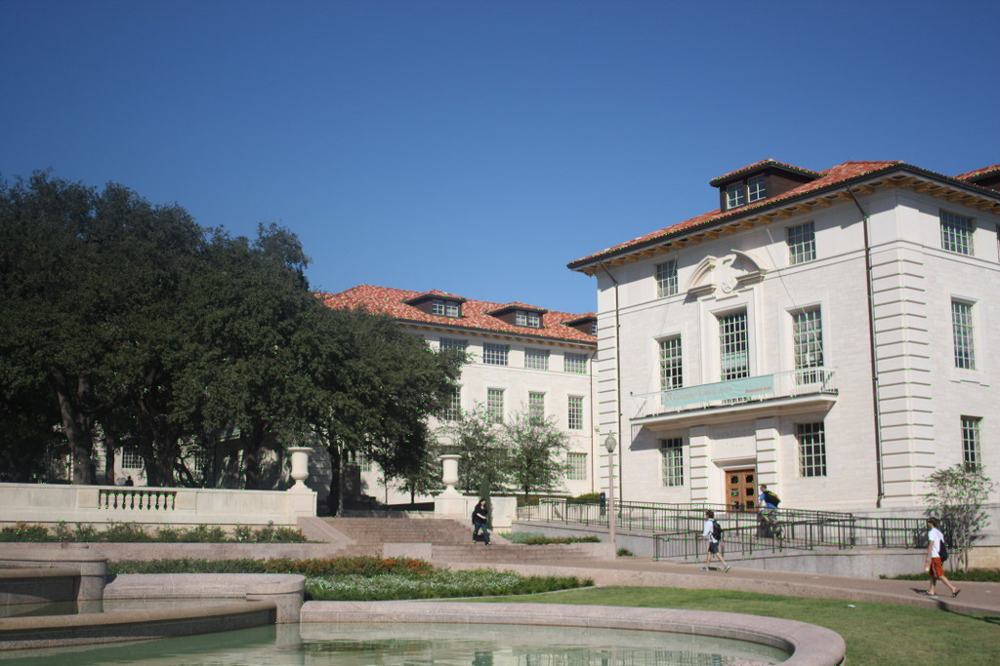

In [ ]:
ret, dst_right = cv2.threshold(dst_right,0.01*dst_right.max(),255,0)
dst_right = np.uint8(dst_right)

# find centroids
ret, labels, stats, centroids = cv2.connectedComponentsWithStats(dst_right)

# define the criteria to stop and refine the corners
criteria_right = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
corners_right = cv2.cornerSubPix(gray_right,np.float32(centroids),(5,5),(-1,-1),criteria_right)
#print(corners_left)    #here u can get corners check for more information follow the link...........http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_features_harris/py_features_harris.html
# Now draw them
res = np.hstack((centroids,corners_right))
res = np.int0(res)
img_right_1 = img_right.copy()
#img_left[res[:,1],res[:,0]]=[0,0,255]
img_right_1[res[:,3],res[:,2]] = [0,255,0]

cv2_imshow(img_right_1)

In [ ]:
corner_keypoints_right = [cv2.KeyPoint(pt[0], pt[1], 13) for pt in corners_right]

print(corner_keypoints_right)

[<KeyPoint 0x7f4c281c3360>, <KeyPoint 0x7f4c281c36c0>, <KeyPoint 0x7f4c281c3240>, <KeyPoint 0x7f4c281c3090>, <KeyPoint 0x7f4c281c3780>, <KeyPoint 0x7f4c281c3630>, <KeyPoint 0x7f4c281c37b0>, <KeyPoint 0x7f4c281c37e0>, <KeyPoint 0x7f4c281c3210>, <KeyPoint 0x7f4c281c3a80>, <KeyPoint 0x7f4c281c31b0>, <KeyPoint 0x7f4c281c3480>, <KeyPoint 0x7f4c281c31e0>, <KeyPoint 0x7f4c281c35a0>, <KeyPoint 0x7f4c281c3600>, <KeyPoint 0x7f4c281c3a50>, <KeyPoint 0x7f4c281c3960>, <KeyPoint 0x7f4c281c3510>, <KeyPoint 0x7f4c281c3270>, <KeyPoint 0x7f4c281c3300>, <KeyPoint 0x7f4c281c33f0>, <KeyPoint 0x7f4c281c3570>, <KeyPoint 0x7f4c281c36f0>, <KeyPoint 0x7f4c281c3870>, <KeyPoint 0x7f4c281c34e0>, <KeyPoint 0x7f4c281c3930>, <KeyPoint 0x7f4c281c3540>, <KeyPoint 0x7f4c281c3900>, <KeyPoint 0x7f4c281c3a20>, <KeyPoint 0x7f4c281c3750>, <KeyPoint 0x7f4c281c30c0>, <KeyPoint 0x7f4c281c3ea0>, <KeyPoint 0x7f4c281c33c0>, <KeyPoint 0x7f4c281c3420>, <KeyPoint 0x7f4c281c3390>, <KeyPoint 0x7f4c281c3b10>, <KeyPoint 0x7f4c281c3120>, 

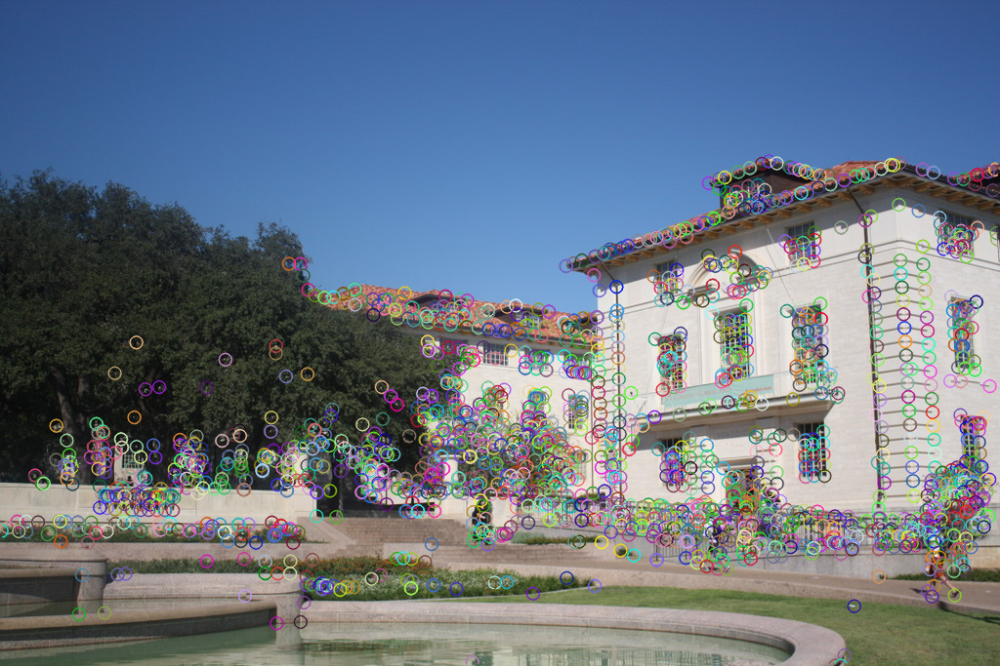

In [ ]:
mg=cv2.drawKeypoints(img_right, corner_keypoints_right, None, 
    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2_imshow(mg)

In [ ]:
f = cv2.BRISK_create()
#keypoints = f.detect(img)
descriptors_right = f.compute(img_right,corner_keypoints_right)
descriptors_right = descriptors_right[1]

In [ ]:
import matplotlib.pyplot as plt
!pip3 install opencv-contrib-python

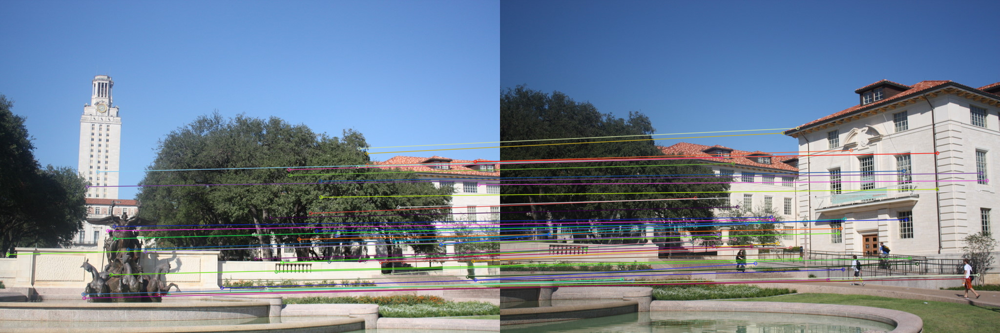

In [ ]:
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_left,descriptors_right)
matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(img_left, corner_keypoints_left, img_right, corner_keypoints_right, matches[:50], img_right, flags=2)
cv2_imshow(img3)
#plt.imshow(img3),plt.show()

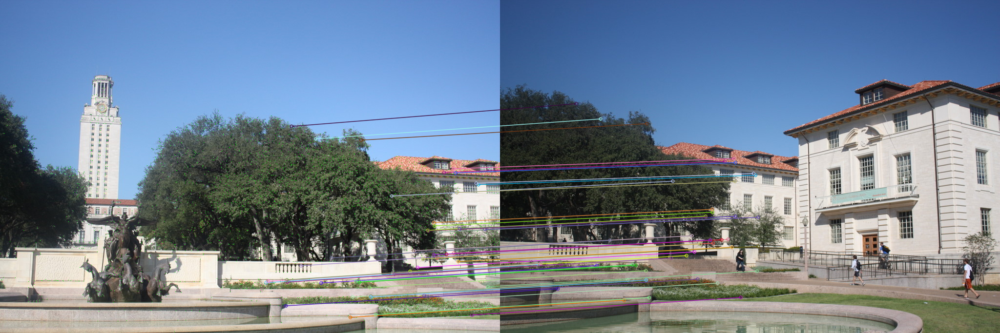

In [ ]:

img1 = cv2.imread('left1.jpg')  
img2 = cv2.imread('right1.jpg') 

img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

#sift
sift = cv2.BRISK_create()

# kp = sift.detect(img1,None)

# # compute the descriptors with ORB
# kp, des = orb.compute(img1, kp)

#print(des)

key_1 = sift.detect(img1)
key_2 = sift.detect(img2)

descriptors_1 = sift.compute(img1,key_1)
descriptors_2 = sift.compute(img2,key_2)

#keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
#keypoints_2, descriptors_2 = sift.detectAndCompute(img2,None)

  #feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)

matches = bf.match(descriptors_1[1],descriptors_2[1])
matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(img_left, key_1, img_right, key_2, matches[:50], img_right, flags=2)
cv2_imshow(img3)
#plt.imshow(img3),plt.show()

In [ ]:
mg=cv2.drawKeypoints(img1, keypoints_1, None, 
    flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
cv2_imshow(mg)

NameError: ignored

In [ ]:
print(type(descriptors_1))

In [ ]:
# # compute SIFT descriptors from corner keypoints
# sift = cv2.xfeatures2d.SIFT_create()
# eye_corner_descriptors = [sift.compute(gray,[kp])[1] for kp in eye_corner_keypoints]

In [ ]:
# orb = cv2.ORB_create(nfeatures=500)
# kp1, des1 = orb.detectAndCompute(img, None)
# #kp2, des2 = orb.detectAndCompute(img2, None)

# print(kp1)

In [ ]:
# f = cv2.BRISK_create()
# keypoints = f.detect(img)
# print(type(keypoints[0]))

In [ ]:
filename = 'left1.jpg'
img = cv2.imread(filename)
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

# # find Harris corners
# gray = np.float32(gray)
# dst = cv2.cornerHarris(gray,2,3,0.04)
# dst = cv2.dilate(dst,None)

# ret, dst = cv2.threshold(dst,0.01*dst.max(),255,0)
# dst = np.uint8(dst)

# # find centroids
# ret, labels, stats, centroids = cv2.connectedComponentsWithStats(dst)

# # define the criteria to stop and refine the corners
# criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
# corners = cv2.cornerSubPix(gray,np.float32(centroids),(5,5),(-1,-1),criteria)
# print(corners)    #here u can get corners check for more information follow the link...........http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_feature2d/py_features_harris/py_features_harris.html
# # Now draw them
# res = np.hstack((centroids,corners))
# res = np.int0(res)
# img[res[:,1],res[:,0]]=[0,0,255]
# img[res[:,3],res[:,2]] = [0,255,0]

cv2_imshow(img)

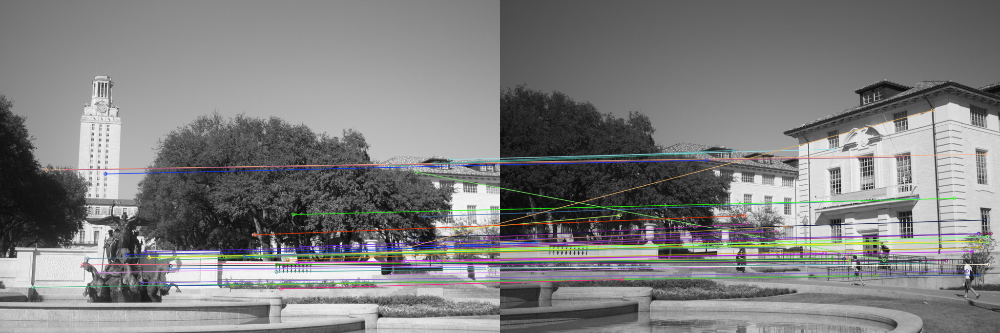

In [ ]:
filename1 = 'left1.jpg'
filename2 = 'right1.jpg'
img1 = cv2.imread(filename1)
img2 = cv2.imread(filename2)
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# Harris corners
dst1 = cv2.cornerHarris(gray1, 2, 3, 0.04)
dst2 = cv2.cornerHarris(gray2, 2, 3, 0.04)

ret1, dst1 = cv2.threshold(dst1, 0.01 * dst1.max(), 255, 0)
ret2, dst2 = cv2.threshold(dst2, 0.01 * dst2.max(), 255, 0)
dst1 = np.uint8(dst1)
dst2 = np.uint8(dst2)

ret1, labels1, stats1, centroids1 = cv2.connectedComponentsWithStats(dst1)
criteria1 = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
corners1 = cv2.cornerSubPix(gray1, np.float32(centroids1), (5, 5), (-1, -1), criteria1)

ret2, labels2, stats2, centroids2 = cv2.connectedComponentsWithStats(dst2)
criteria2 = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
corners2 = cv2.cornerSubPix(gray2, np.float32(centroids2), (5, 5), (-1, -1), criteria2)


# Calculate SIFT descriptors
'''
To stitch two images together we need to find some points in common between the two images.
These points that we call keypoints must be stable: if we modify the image through a series of transformation,
this points must not change.

'''
keypoints1 = [cv2.KeyPoint(crn[0], crn[1], 13) for crn in corners1]
keypoints2 = [cv2.KeyPoint(crn[0], crn[1], 13) for crn in corners2]

f = cv2.ORB_create()
#descriptors1 = [f.compute(gray1, [kp]) for kp in keypoints1]
#descriptors2 = [f.compute(gray2, [kp]) for kp in keypoints2]

descriptors_1 = f.compute(img1,keypoints1)
descriptors_2 = f.compute(img2,keypoints2)

#keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
#keypoints_2, descriptors_2 = sift.detectAndCompute(img2,None)

  #feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
#print(descriptors1)


descriptors_1 = descriptors_1[1]
descriptors_2 = descriptors_2[1]

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(gray1, keypoints1, gray2, keypoints2, matches[:50], gray2, flags=2)
cv2_imshow(img3)

#print(descriptors1)

In [ ]:
n_1 = []
n_2 = []
for row in descriptors_1:
  norm_row = (row - row.mean()) / row.std()
  n_1.append(norm_row.tolist())

for row in descriptors_2:
  norm_row = (row - row.mean()) / row.std()
  n_2.append(norm_row.tolist())

#print(n_1)
n_1 = np.array(n_1)
n_2 = np.array(n_2)
#print(n_1[1000].mean(),n_1[1000].std())

0.0 1.0 float32


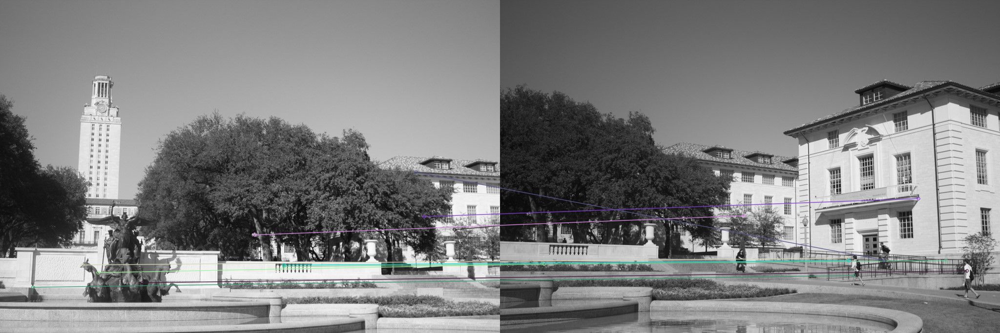

In [ ]:
#normed_1 = (descriptors_1 - descriptors_1.mean(axis=1)) / descriptors_1.std(axis=1)
#normed_2 = (descriptors_2 - descriptors_2.mean(axis=1)) / descriptors_2.std(axis=1)

n_1 = np.float32(n_1)
n_2 = np.float32(n_2)

#print(descriptors_1.dtype, descriptors_2.shape)
#print(normed_1.dtype, normed_2.shape)
print(n_2[1000].mean(),n_2[1000].std(),n_1.dtype)

bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
#print(descriptors1)

matches = bf.match(n_1,n_2)
matches = sorted(matches, key = lambda x:x.distance)
#print()
#matches = bf.match(normed_1,normed_2)
#matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(gray1, keypoints1, gray2, keypoints2, matches[:10], gray2, flags=2)
cv2_imshow(img3)

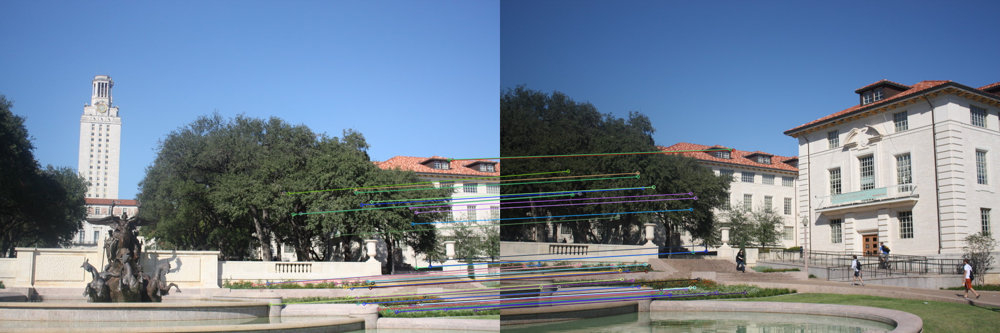

In [8]:
#fast = cv2.FastFeatureDetector_create()

# find and draw the keypoints




filename1 = 'left1.jpg'
filename2 = 'right1.jpg'
img1 = cv2.imread(filename1)
img2 = cv2.imread(filename2)
gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# # Harris corners
dst1 = cv2.cornerHarris(gray1, 2, 3, 0.04)
dst2 = cv2.cornerHarris(gray2, 2, 3, 0.04)

ret1, dst1 = cv2.threshold(dst1, 0.01 * dst1.max(), 255, 0)
ret2, dst2 = cv2.threshold(dst2, 0.01 * dst2.max(), 255, 0)
dst1 = np.uint8(dst1)
dst2 = np.uint8(dst2)

ret1, labels1, stats1, centroids1 = cv2.connectedComponentsWithStats(dst1)
criteria1 = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
corners1 = cv2.cornerSubPix(gray1, np.float32(centroids1), (5, 5), (-1, -1), criteria1)

ret2, labels2, stats2, centroids2 = cv2.connectedComponentsWithStats(dst2)
criteria2 = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.001)
corners2 = cv2.cornerSubPix(gray2, np.float32(centroids2), (5, 5), (-1, -1), criteria2)


# # Calculate SIFT descriptors
# '''
# To stitch two images together we need to find some points in common between the two images.
# These points that we call keypoints must be stable: if we modify the image through a series of transformation,
# this points must not change.

# '''
keypoints1 = [cv2.KeyPoint(crn[0], crn[1], 13) for crn in corners1]
keypoints2 = [cv2.KeyPoint(crn[0], crn[1], 13) for crn in corners2]


#keypoints1 = fast.detect(img1,None)
#keypoints2 = fast.detect(img2,None)

#print(keypoints1)

f = cv2.SIFT_create()

#descriptors1 = [f.compute(gray1, [kp]) for kp in keypoints1]
#descriptors2 = [f.compute(gray2, [kp]) for kp in keypoints2]

descriptors_1 = f.compute(img1,keypoints1)
descriptors_2 = f.compute(img2,keypoints2)

#keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
#keypoints_2, descriptors_2 = sift.detectAndCompute(img2,None)

  #feature matching
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
#print(descriptors1)


descriptors_1 = descriptors_1[1]
descriptors_2 = descriptors_2[1]

matches = bf.match(descriptors_1,descriptors_2)
matches = sorted(matches, key = lambda x:x.distance)

img3 = cv2.drawMatches(img1, keypoints1, img2, keypoints2, matches[:50], img2, flags=2)
cv2_imshow(img3)

#print(descriptors1)

In [9]:
n_1 = []
n_2 = []
for row in descriptors_1:
  norm_row = (row - row.mean()) / row.std()
  n_1.append(norm_row.tolist())

for row in descriptors_2:
  norm_row = (row - row.mean()) / row.std()
  n_2.append(norm_row.tolist())

#print(n_1)
n_1 = np.array(n_1)
n_2 = np.array(n_2)
#print(n_1[1000].mean(),n_1[1000].std())

<class 'cv2.DMatch'>


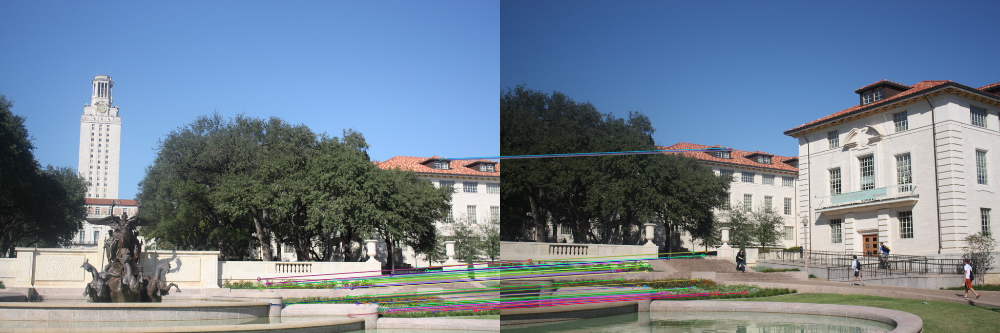

In [12]:
n_1 = np.float32(n_1)
n_2 = np.float32(n_2)

#print(descriptors_1.dtype, descriptors_2.shape)
#print(normed_1.dtype, normed_2.shape)
#print(n_2[1000].mean(),n_2[1000].std(),n_1.shape)

bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
#print(descriptors1)

matches = bf.match(n_1,n_2)
matches = sorted(matches, key = lambda x:x.distance)
#print()
#matches = bf.match(normed_1,normed_2)
#matches = sorted(matches, key = lambda x:x.distance)
print(type(matches[0]))
img3 = cv2.drawMatches(img1, keypoints1, img2, keypoints2, matches[:50], img3, flags=2)
cv2_imshow(img3)

In [1]:
!pip install opencv-contrib-python==4.4.0.44

['Requirement already satisfied: opencv-contrib-python==4.4.0.44 in /usr/local/lib/python3.7/dist-packages (4.4.0.44)',
 'Requirement already satisfied: numpy>=1.14.5 in /usr/local/lib/python3.7/dist-packages (from opencv-contrib-python==4.4.0.44) (1.19.5)']

In [4]:
print (cv2 .__version__)

4.4.0


In [16]:
m = []
i = 0
for row1 in descriptors_1:
  j = 0
  for row2 in descriptors_2:
    dist = np.linalg.norm(row1 - row2)
    m.append(cv2.DMatch(i,j,dist))
    j += 1
  i += 1

print(m)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

